In [238]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

import sys
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold
from sklearn.preprocessing import LabelEncoder

from catboost import CatBoostRegressor, Pool

from tqdm.notebook import tqdm

from joblib import Parallel, delayed
from bs4 import BeautifulSoup  as bs
from pprint import pprint  
import requests  
import json
from ast import literal_eval
import json

import matplotlib.pyplot as plt
import seaborn as sns
from pandas_profiling import ProfileReport
from sklearn.preprocessing import StandardScaler

import my_func
import importlib
importlib.reload(my_func)

from IPython.display import Audio
from russian_names import RussianNames

In [239]:
!pip freeze > requirements.txt
RANDOM_SEED = 42

In [240]:
def mape(y_true, y_pred):
    return np.mean(np.abs((y_pred-y_true)/y_true))

In [241]:
pd.set_option('float_format', '{:f}'.format)
pd.set_option('display.max_colwidth', 100)

In [242]:
input_folder = 'data_versions/' 

In [243]:
train = pd.read_csv(input_folder + 'parsed_data_1.csv')
train.dropna(subset=['price'], inplace=True)
# Почистим от дубликатов

# print(data.sell_id.value_counts())
print('Размер до очистки от дублей', train.shape)
train.drop_duplicates(subset ="sell_id", keep = False, inplace = True)
print('Размер после очистки от дублей', train.shape)

test = pd.read_csv('kaggle/test.csv')

sample_submission = pd.read_csv('kaggle/sample_submission.csv')

Размер до очистки от дублей (88297, 29)
Размер после очистки от дублей (86429, 29)


In [244]:
# CATBOOST
ITERATIONS = 5000
LR         = 0.1

In [245]:
df_train = train
df_test = test
# ВАЖНО! дря корректной обработки признаков объединяем трейн и тест в один датасет
df_train['sample'] = 1 # помечаем где у нас трейн
df_test['sample'] = 0 # помечаем где у нас тест

data = df_test.append(df_train, sort=False).reset_index(drop=True) # объединяем
data.columns = ['bodyType', 'brand', 'car_url', 'color', 'complectation_dict',
       'description', 'engineDisplacement', 'enginePower', 'equipment_dict',
       'fuelType', 'image', 'mileage', 'modelDate', 'model_info', 'model_name',
       'name', 'numberOfDoors', 'parsing_unixtime', 'priceCurrency',
       'productionDate', 'sell_id', 'super_gen', 'vehicleConfiguration',
       'vehicleTransmission', 'vendor', 'owners', 'owning', 'pts', 'privod', 'wheel', 
       'state', 'customs', 'sample', 'Unnamed: 0','seller_name', 'price']

In [246]:
print('категории','\n', train.select_dtypes(np.object).columns)
print('нумерные','\n', train._get_numeric_data().columns)

категории 
 Index(['brand', 'model_name', 'car_url', 'equipment_dict', 'bodyType', 'color',
       'engineDisplacement', 'fuelType', 'priceCurrency', 'super_gen',
       'vehicleTransmission', 'Владельцы', 'ПТС', 'Владение', 'Привод', 'Руль',
       'Состояние', 'Таможня', 'description', 'seller_name'],
      dtype='object')
нумерные 
 Index(['Unnamed: 0', 'productionDate', 'enginePower', 'mileage', 'modelDate',
       'numberOfDoors', 'sell_id', 'parsing_unixtime', 'price', 'sample'],
      dtype='object')


# PREPROCESSING

In [247]:

data.drop('complectation_dict', axis=1, inplace=True, errors='ignore')
data.drop('image', axis=1, inplace=True, errors='ignore')
data.drop('model_info', axis=1, inplace=True, errors='ignore')
data.drop('name', axis=1, inplace=True, errors='ignore')
data.drop('vendor', axis=1, inplace=True, errors='ignore')
data.drop('Unnamed: 0', axis=1, inplace=True, errors='ignore')
data.drop('priceCurrency', axis=1, inplace=True, errors='ignore')
data.drop('vehicleConfiguration', axis=1, inplace=True, errors='ignore')
data.drop('super_gen', axis=1, inplace=True, errors='ignore')
data.drop('seller_name', axis=1, inplace=True, errors='ignore')
data['owners'] = data['owners'].astype('category').cat.codes

data['enginePower'] = data['enginePower'].apply(lambda x: int(x.replace(' N12', '')) if type(x)==str else x)
data['engineDisplacement'] = data['engineDisplacement'].apply(lambda x: pd.to_numeric(x.replace(' LTR', '')) if type(x)==str else x)

data.drop('customs', axis=1, inplace=True, errors='ignore')

# Выбросы

In [248]:
print('граница выбросов километража: ' ,my_func.outlier_treatment(data.mileage))
# Оставим значения свыше границы, но в пределах 400к,
# Остальные значения закодируем
data['mileage600'] = data['mileage'].apply(lambda x: 1 if x>600 else 0)
data['mileage'] = data['mileage'].apply(lambda x: 400_000 if x>400_000 else x)

граница выбросов километража:  (-154328.75, 399797.25)


# ПРОПУСКИ

In [249]:
mileage_proddate = data[data.mileage!=0].groupby(by='productionDate').mileage.mean().tail(50)
mask0milage = data['mileage']==0
data['mileage'].loc[mask0milage] = data.loc[mask0milage].productionDate.apply(lambda x: mileage_proddate[x])

In [250]:
# data.loc[mask0milage].productionDate.value_counts()

In [251]:
# Просто сносим пропуски, где их незначительно мало

data.dropna(subset=['bodyType'], inplace=True)
data.dropna(subset=['enginePower'], inplace=True)


In [252]:
# Заполняем 
data['color'].fillna(method='ffill', inplace=True)

data['owners'] = data['owners'] + 1 # пока будем считать, что NaN это машины без проката, 
                                    # т.е. оставим присвоенные после кодировки значения, прибавив к всему столбу 1, 
                                    # чтобы выравнить до неотрицательных по всей колонке

data['equipment_dict'].fillna('{"not_specified":true}', inplace=True)
# data['owning'].fillna('0', inplace=True)
data['pts'].fillna('0', inplace=True)

data['wheel'].fillna('not_specified', inplace=True)
data['privod'].fillna('not_specified', inplace=True)
data['state'].fillna('not_specified', inplace=True)


data.description.fillna('пусто', inplace=True)
# data['customs'].fillna('not_specified', inplace=True)

In [253]:
# Обработка даты
def str_timedelta(string):
    import re
    string = string.replace(' года', 'Y')
    string = string.replace(' лет', 'Y')
    string = string.replace(' год', 'Y')
    string = string.replace(' и ', '')
    string = string.replace(' месяца', 'm')
    string = string.replace(' месяцев', 'm')
    string = string.replace(' месяц', 'm')
    try:
        year_part = int(re.findall(r"(\d+)m", string)[-1]) / 12
        year_part = str(round(year_part, 3)) + 'y'
    except:
        year_part = 0
    td_y = pd.to_timedelta(string).days
    td_m = pd.to_timedelta(year_part).days
    td = td_y + td_m
    return td

mask = data.owning.isna()==False
data['owning'].loc[mask] = data['owning'].loc[mask].map(str_timedelta)
data['owning'].loc[mask] = pd.to_numeric(data['owning'].loc[mask])
data['owning'].fillna(0, inplace=True)


# data.drop('owning', axis=1, inplace=True, errors='ignore')

In [254]:
print('категории','\n', data.select_dtypes(np.object).columns)
print('нумерные','\n', data._get_numeric_data().columns)

категории 
 Index(['bodyType', 'brand', 'car_url', 'color', 'description',
       'equipment_dict', 'fuelType', 'model_name', 'vehicleTransmission',
       'pts', 'privod', 'wheel', 'state'],
      dtype='object')
нумерные 
 Index(['engineDisplacement', 'enginePower', 'mileage', 'modelDate',
       'numberOfDoors', 'parsing_unixtime', 'productionDate', 'sell_id',
       'owners', 'owning', 'sample', 'price', 'mileage600'],
      dtype='object')


In [255]:
cat_features_ids = ['bodyType', 'brand', 'color','descr_labels', 'fuelType', 
                    'model_name', 'vehicleTransmission',
                    'pts', 'privod', 'wheel', 'state']

# Кодирование


In [256]:
# Catboost работает с категорийными признаками в исходном виде, 
# поэтому кодировать ничего не будем

# Feature Genering

In [257]:
print('категории','\n', data.select_dtypes(np.object).columns)
print('нумерные','\n', data._get_numeric_data().columns)

категории 
 Index(['bodyType', 'brand', 'car_url', 'color', 'description',
       'equipment_dict', 'fuelType', 'model_name', 'vehicleTransmission',
       'pts', 'privod', 'wheel', 'state'],
      dtype='object')
нумерные 
 Index(['engineDisplacement', 'enginePower', 'mileage', 'modelDate',
       'numberOfDoors', 'parsing_unixtime', 'productionDate', 'sell_id',
       'owners', 'owning', 'sample', 'price', 'mileage600'],
      dtype='object')


In [258]:
data['engpower_doors'] = data['enginePower'] * data['numberOfDoors']

data['engpower_endisp'] = data['enginePower'].apply(int) * data['engineDisplacement']

data['engpower_owners'] = data['enginePower'] * data['owners']

data['prod-model-date'] = data['productionDate'] - data['modelDate']

In [259]:
data['equipment_dict'] = data.apply(lambda r: list(literal_eval(r['equipment_dict']).keys()) 
                                              if r['sample']==1 else 
                                                  list(json.loads(r['equipment_dict']).keys()), 
                                              axis=1)

In [260]:
data['car_used'] = data['car_url'].apply(lambda x: 1 if 'used' in x else 0)
mask_d = data['car_url'].str.contains('new')
data['description'].loc[mask_d] = 'реклама'
data.drop('car_url', axis=1, inplace=True, errors='ignore')

In [261]:
d_brand_price = dict(data.groupby(by='brand').price.mean())
data['brand_price'] = data['brand'].apply(lambda x: d_brand_price[x])

d_bodyType_price = dict(data.groupby(by='bodyType').price.mean())
data['body_price'] = data['bodyType'].apply(lambda x: d_bodyType_price[x])

d_model_name_price = dict(data.groupby(by='model_name').price.mean())
data['model_name_price'] = data['model_name'].apply(lambda x: d_model_name_price[x])

In [262]:
data[['brand_price', 
      'body_price', 
      'model_name_price']] = data[['brand_price', 
                                   'body_price', 
                                   'model_name_price']].apply(np.log)

In [263]:
d_brand_mileage = dict(data.groupby(by='brand').mileage.mean())
data['brand_mileage'] = data['brand'].apply(lambda x: d_brand_mileage[x])

d_model_name_mileage = dict(data.groupby(by='model_name').mileage.mean())
data['model_name_mileage'] = data['model_name'].apply(lambda x: d_model_name_mileage[x])

# NLP

In [264]:
# import nltk
# nltk.download('stopwords')

In [265]:
data['description'].loc[data.description.apply(len)<=3] = 'пусто'
data['description'].loc[data.description.apply(len)==4] = 'торг'
data['description'].loc[data.description.apply(len)==5] = 'пусто'

In [266]:
# data['description'].loc[data.description.apply(len)==6].value_counts()
from my_func import list_trash_ind
data['description'].loc[list_trash_ind] = 'пусто'

In [267]:
from sklearn.feature_extraction.text import CountVectorizer
from nltk.corpus import stopwords
stopWords = stopwords.words('russian')
# Создаём объект, который будет токенизировать данные
analyzer = CountVectorizer(stop_words=stopWords).build_analyzer()
# Токенизируем наш набор данных
data['description'] = data.description.apply(analyzer)

In [268]:
from gensim.models import Word2Vec
# Обучаем модель векторайзера на нашем наборе данных
# На выходе мы получим вектор признаков для каждого слова
model = Word2Vec(data['description'].loc[:], min_count=20, size=30, seed=RANDOM_SEED)

In [269]:
# Наивный подход к созданию единого эмбеддинга для документа – средний эмбеддинг по словам

# Составляем эмбеддинги для наших объявлений
data['description'] = data.description.apply(lambda x: my_func.doc_vectorizer(x, model))

In [270]:
from sklearn import metrics
from sklearn.cluster import KMeans

CLUSTERS = 5

# Создаём KMeans кластеризатор 
kmeans = KMeans(n_clusters=CLUSTERS, random_state=RANDOM_SEED)
# Обучим кластеризатор на подготовленных данных 
data['descr_labels'] = kmeans.fit_predict(np.asarray(list(data['description'].values)))

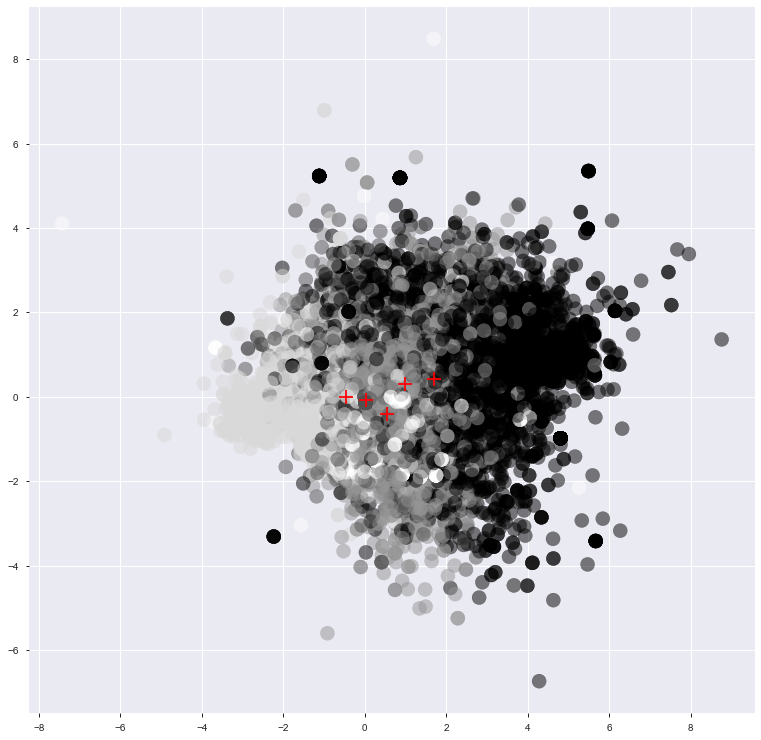

In [271]:
# Графики полученных кластеров
X = np.asarray(list(data['description'].values) )

y_pred = kmeans.labels_.astype(np.int)
colors = ("red", "green", "blue", "yellow")
plt.rcParams['figure.figsize'] = 13, 13
plt.scatter(X[:, 0], X[:, 1], c=y_pred, s=200, alpha=.5)
plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], c='red', s=200, marker='+')
plt.show()


In [272]:
data.drop('description', axis=1, inplace=True, errors='ignore')

In [273]:
cat_features_ids = ['bodyType', 'brand', 'color','descr_labels', 'fuelType', 
                    'model_name', 'vehicleTransmission',
                    'pts', 'privod', 'wheel', 'state', 'descr_labels']

# DUMMY

In [274]:
# for_dummy_cols = ['fuelType',  'vehicleTransmission', 'pts']
# data = pd.get_dummies(data, columns=for_dummy_cols, drop_first=False)

In [275]:
data['equipment_dict'] = data['equipment_dict'].apply(lambda x: ['not_specified'] if len(x)==0 else x)
equip_set = set()
data.equipment_dict.apply(lambda x: equip_set.update(x))
equips_df = pd.DataFrame(columns=list(equip_set), data=np.zeros((data.shape[0], len(equip_set))), dtype=int)
data = pd.concat([equips_df, data], axis=1, join='inner')       
for i in range(data.shape[0]):
    for equip in data.equipment_dict.iloc[i]:

        data[equip].iloc[i] = 1
data.drop('equipment_dict', axis=1, inplace=True, errors='ignore')

# Normalize

In [276]:
# scaler = StandardScaler().fit(data.mileage)
data[['mileage', 'enginePower']] = StandardScaler().fit_transform(data[['mileage', 'enginePower']].values)

# Подготовка данных для модели

In [301]:
data.to_csv('data_for_stacking.csv')

In [277]:
# data.drop('sell_id', axis=1, inplace=True, errors='ignore')

X = data.query('sample == 1').drop(['sample'], axis=1)
y = X['price']

X.drop('price', axis=1, inplace=True, errors='ignore')
X_sub = data.query('sample == 0').drop(['sample', 'price'], axis=1)

In [278]:
VAL_SIZE=0.20
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=VAL_SIZE, shuffle=True, random_state=RANDOM_SEED)

In [279]:
y_train = np.log(y_train)
y_test = np.log(y_test)

In [280]:
# CHANGEs COMMENT
changes_comment = ''

# MODEL

In [281]:
# CATBOOST
ITERATIONS = 5000
LR         = 0.09399760402267439 #0.08343057119918101 #0.1
depth = 12

In [282]:
train_pool = Pool(
    X_train,
    y_train,
    cat_features=cat_features_ids,
) 
test_pool = Pool(
    X_test,
    y_test,
    cat_features=cat_features_ids,
)

model = CatBoostRegressor(iterations = ITERATIONS,
                          learning_rate = LR,
                          random_seed = RANDOM_SEED,
                          eval_metric='MAPE',
                          custom_metric=['R2', 'MAE'],
                          l2_leaf_reg=1,
                          depth=12,
                          metric_period=depth,
                          od_type='Iter',
                          od_wait=20,
                          rsm=0.2,
                          devices='GPU'
                         )
model.fit(train_pool,
         eval_set=test_pool,
         verbose_eval=depth,
         use_best_model=True,
         plot=False
         )

0:	learn: 0.0664456	test: 0.0665812	best: 0.0665812 (0)	total: 240ms	remaining: 19m 58s
12:	learn: 0.0266109	test: 0.0268059	best: 0.0268059 (12)	total: 2.91s	remaining: 18m 35s
24:	learn: 0.0156459	test: 0.0159769	best: 0.0159769 (24)	total: 5.61s	remaining: 18m 35s
36:	learn: 0.0128463	test: 0.0133637	best: 0.0133637 (36)	total: 8.21s	remaining: 18m 22s
48:	learn: 0.0118762	test: 0.0125376	best: 0.0125376 (48)	total: 10.9s	remaining: 18m 19s
60:	learn: 0.0112953	test: 0.0121484	best: 0.0121484 (60)	total: 13.5s	remaining: 18m 12s
72:	learn: 0.0108449	test: 0.0118536	best: 0.0118536 (72)	total: 16.3s	remaining: 18m 21s
84:	learn: 0.0105406	test: 0.0116808	best: 0.0116808 (84)	total: 19s	remaining: 18m 18s
96:	learn: 0.0102354	test: 0.0114922	best: 0.0114922 (96)	total: 21.7s	remaining: 18m 15s
108:	learn: 0.0099650	test: 0.0113368	best: 0.0113368 (108)	total: 25s	remaining: 18m 43s
120:	learn: 0.0097358	test: 0.0112349	best: 0.0112349 (120)	total: 27.7s	remaining: 18m 37s
132:	learn: 

<AxesSubplot:ylabel='Feature Id'>

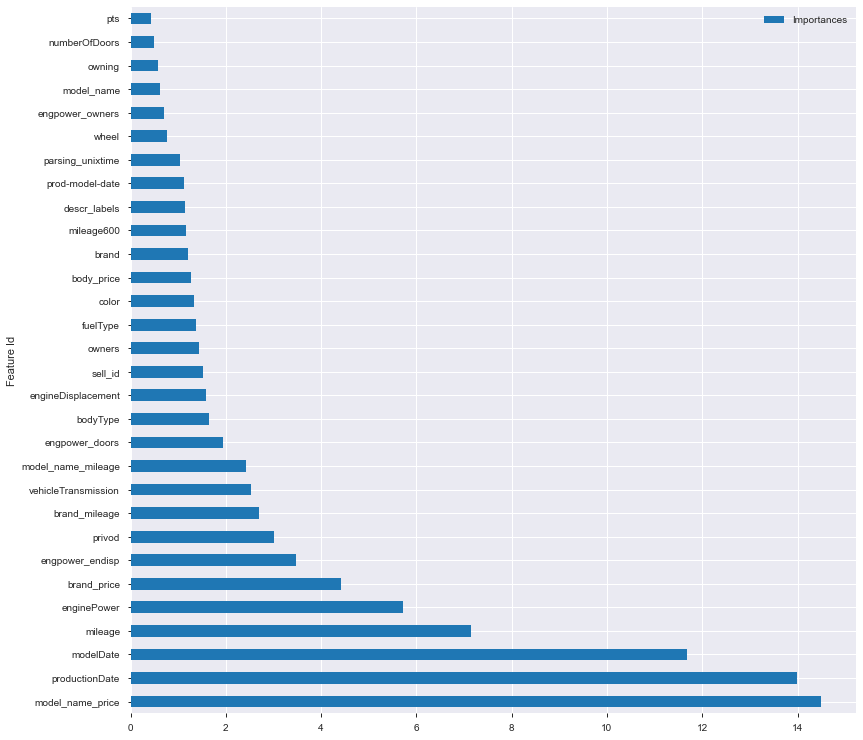

In [283]:
imp_features = model.get_feature_importance(prettified=True)[:30]
imp_features.sort_values(by='Importances',inplace=True, ascending=False)
imp_features.set_index('Feature Id', inplace=True)
imp_features.plot(kind='barh')

In [284]:
# model.drop_unused_features()
# model.feature_names_

In [285]:
predict = model.predict(X_test)

predict = np.e ** predict
y_test = np.e ** y_test

# оцениваем точность
MAPE = f'{(mape(y_test, predict))*100:0.4f}'
print(f"Точность модели по метрике MAPE: {MAPE}%")

Точность модели по метрике MAPE: 13.3854%


In [286]:
predict_1 = np.round(predict // 10000) * 10000
MAPE10k = f'{(mape(y_test, predict_1))*100:0.4f}'
print(f"Точность модели по метрике MAPE: {MAPE10k}%")

Точность модели по метрике MAPE: 13.1603%


In [287]:
predict_2 = predict // 1000 * 1000
MAPE = f'{(mape(y_test, predict_2))*100:0.4f}'
print(f"Точность модели по метрике MAPE: {MAPE}%")

Точность модели по метрике MAPE: 13.3572%


In [288]:
import winsound
freq = 2000 # Set frequency To 2500 Hertz
dur = 700 # Set duration To 1000 ms == 1 second
winsound.Beep(freq, dur) 

# SUBMISSION

In [289]:
print('update sub version')
version_ser = pd.read_csv('kaggle/submissions_kaggle/sub_version.csv', index_col=0)
new_version = version_ser['sub_version'].loc[0] + 1
new_version_list = pd.DataFrame({'sub_version': new_version, 'sub_dt' : pd.Timestamp.today(), 'MAPE': MAPE , 'MAPE10k': MAPE10k, 'comment': changes_comment}, index =[0])
version_ser = pd.concat([new_version_list, version_ser[:]]).reset_index(drop = True)
version_ser.to_csv('kaggle/submissions_kaggle/sub_version.csv', index='index')
print(version_ser.head(5))

update sub version
   sub_version                      sub_dt      MAPE   MAPE10k  \
0           87  2020-11-25 21:44:11.100719   13.3572   13.1603   
1           86  2020-11-25 20:49:05.160106 13.393300 13.186700   
2           85  2020-11-25 20:33:22.161051 13.253300 13.065000   
3           84  2020-11-25 19:51:05.144362 13.344700 13.146200   
4           83  2020-11-25 19:37:09.437859 13.398000 13.199900   

                                                              comment  
0                                                                      
1                              addcats selname descrLabel seller_isNA  
2                                          addcats selname descrLabel  
3  depth12 lr09 descr_labels=5 brand_mileage model_mileage -logEngPow  
4  depth12 lr09 descr_labels=5 brand_mileage model_mileage -logEngPow  


In [290]:
predict_submission = model.predict(X_sub)
predict_submission = np.e ** predict_submission
predict_submission = predict_submission // 10000 * 10000
sample_submission['price'] = predict_submission
sample_submission.to_csv(f'kaggle\submissions_kaggle\submission_{new_version}.csv', index=False)
sample_submission.head(5)

,sell_id,price
0,1100575026,610000.000000
1,1100549428,990000.000000
2,1100658222,880000.000000
3,1100937408,740000.000000
4,1101037972,700000.000000


# Изучаем ошибки

In [291]:
# pd.DataFrame(columns=['predict', 'true'] , data=[predict, y_test.values])
errors = {'index': y_test.index,'true': y_test.values, 'predict': predict, 'diff': (y_test.values - predict)}
errors = pd.DataFrame(errors)
abs(errors['diff']).mean()

121226.58422178331

In [292]:
errors[abs(errors['diff']).between(500_000, 7000_000)].true.mean()
abs(errors['diff']).sort_values(ascending=False).head(20)

10700   50897862.871158
4920    19025296.714032
15645   15072940.854591
9701    12433296.086770
10606    8706805.235067
7179     7830478.489369
6510     7665829.233096
11324    7582368.592208
9357     7495862.116710
8663     7479743.020975
5716     7446778.925174
16354    6729405.340579
7908     6542325.852053
10334    5778357.961238
15947    5291713.624289
2008     5127274.380076
1054     4872479.069166
3074     4836044.704945
8561     4815012.175326
5564     4815012.175326
Name: diff, dtype: float64

In [293]:
errors.loc[6310]

index      96606.000000
true      500000.000000
predict   545677.537299
diff      -45677.537299
Name: 6310, dtype: float64

In [294]:
train = pd.read_csv(input_folder + 'parsed_data_1.csv')
train.dropna(subset=['price'], inplace=True)
# Почистим от дубликатов

# print(data.sell_id.value_counts())
print('Размер до очистки от дублей', train.shape)
train.drop_duplicates(subset ="sell_id", keep = False, inplace = True)
print('Размер после очистки от дублей', train.shape)

test = pd.read_csv('kaggle/test.csv')
# test.dropna(subset=['price'], inplace=True)

sample_submission = pd.read_csv('kaggle/sample_submission.csv')

df_train = train
df_test = test
# ВАЖНО! дря корректной обработки признаков объединяем трейн и тест в один датасет
df_train['sample'] = 1 # помечаем где у нас трейн
df_test['sample'] = 0 # помечаем где у нас тест

data_errors = df_test.append(df_train, sort=False).reset_index(drop=True) # объединяем
data_errors.columns = ['bodyType', 'brand', 'car_url', 'color', 'complectation_dict',
       'description', 'engineDisplacement', 'enginePower', 'equipment_dict',
       'fuelType', 'image', 'mileage', 'modelDate', 'model_info', 'model_name',
       'name', 'numberOfDoors', 'parsing_unixtime', 'priceCurrency',
       'productionDate', 'sell_id', 'super_gen', 'vehicleConfiguration',
       'vehicleTransmission', 'vendor', 'owners', 'owning', 'pts', 'privod', 'wheel', 
       'state', 'customs', 'sample', 'Unnamed: 0','seller_name', 'price']

Размер до очистки от дублей (88297, 29)
Размер после очистки от дублей (86429, 29)


In [295]:
errors500 = errors[errors['diff']>500_000]['index'].values
errors500
# data_errors = data_errors.loc[errors500]

array([ 81652,  87360,  40518, 118577,  91327,  67229,  61447,  82294,
        75081,  43786,  36772,  43952,  50822, 116303,  36868, 118884,
        99640,  98128,  38885,  82391,  98071, 105823,  44698,  87628,
        42655, 109899,  83656,  51556,  56626, 119357, 108860,  38485,
        83364, 111450,  39832,  87355,  37369,  99271,  87605,  83962,
        66618,  50921,  75439,  83546,  67767,  84478,  84022, 119540,
        99993,  42915,  83097,  42946,  84255,  83529,  56628,  61749,
        76546,  42681,  46509,  42654,  83336,  80516,  59590,  79359,
        79826,  99999,  82693,  79566,  42576,  79488,  99622,  42982,
        37428,  42767,  77430,  99467,  80530,  43925,  50823,  81962,
        75784,  79329,  43255,  37188,  99986,  34833,  41590,  84208,
        81904, 118998,  37561, 110298,  89827,  86001,  38080, 109961,
        54702,  76189, 119609,  85831,  82221,  50340,  86205,  47420,
        76801, 117009,  67452,  81983, 109957,  85169,  45540,  44623,
      

<AxesSubplot:>

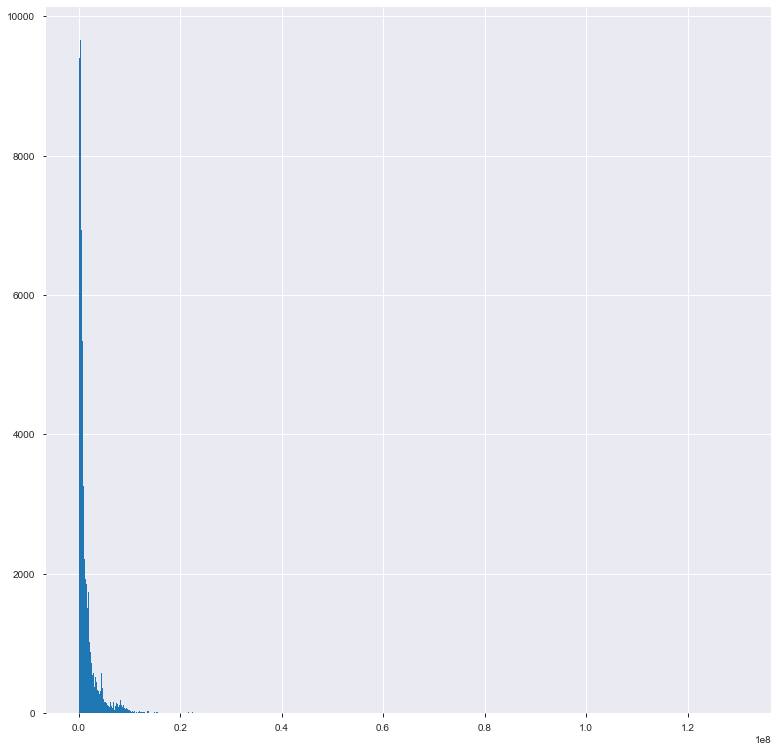

In [296]:
data_errors['price'].hist(bins=1000)

In [297]:
errors[errors['diff']>500_000]

,index,true,predict,diff
2,81652,3500000.000000,2033925.922498,1466074.077502
159,87360,6502270.000000,4869087.220651,1633182.779349
256,40518,2900000.000000,2343629.500913,556370.499087
275,118577,5501200.000000,4997098.141857,504101.858143
314,91327,1300000.000000,609969.071942,690030.928058
...,...,...,...,...
16985,75429,3000000.000000,1937848.071415,1062151.928585
17033,81086,2250000.000000,1539369.754472,710630.245528
17089,99835,6700000.000000,5837269.210597,862730.789403
17149,43058,10376424.000000,9686773.443696,689650.556304


In [298]:
# np.log(data['price'])
np.e ** (np.log(data[data['sample']==1]['price']))

34686    11000000.000000
34687     1800000.000000
34688     6950000.000000
34689      350000.000000
34690      590000.000000
               ...      
121107    1178400.000000
121108    1319000.000000
121109    1158900.000000
121110    1410900.000000
121111    1424900.000000
Name: price, Length: 86423, dtype: float64

In [299]:
np.e ** 14.403297

1799999.598840536

In [300]:
data[data['sample']==1]['price']

34686    11000000.000000
34687     1800000.000000
34688     6950000.000000
34689      350000.000000
34690      590000.000000
               ...      
121107    1178400.000000
121108    1319000.000000
121109    1158900.000000
121110    1410900.000000
121111    1424900.000000
Name: price, Length: 86423, dtype: float64